In [1]:
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import TruncatedSVD
from hdbscan import HDBSCAN
from umap import UMAP

from common import data_dir, GMT

In [2]:
# df = pd.read_csv("data/rummagenexrummageo_sym4_500k.csv")
# df

In [3]:
# max(df["n-overlap"].tolist())

In [4]:
# import json
# from common import data_dir, cached_urlretrieve, maybe_tqdm

# (data_dir/'Enrichr').mkdir(parents=True, exist_ok=True)

# cached_urlretrieve(
#   'https://maayanlab.cloud/Enrichr/datasetStatistics',
#   data_dir/'Enrichr'/'datasetStatistics.json'
# )
# with (data_dir/'Enrichr'/'datasetStatistics.json').open('r') as fr:
#   datasetStatistics = json.load(fr)
# datasetStatistics

# for library in maybe_tqdm(datasetStatistics['statistics'], desc='Downloading Enrichr database...'):
#   cached_urlretrieve(
#     f"https://maayanlab.cloud/Enrichr/geneSetLibrary?mode=text&libraryName={library['libraryName']}",
#     data_dir/'Enrichr'/(library['libraryName']+'.gmt')
#   )

In [5]:
# from common import data_dir, GMT, maybe_tqdm


# with (data_dir/'enrichr.gmt').open('w') as fw:
#   for gene_set_library in maybe_tqdm((data_dir/'Enrichr').glob('*.gmt'), desc='Processing enrichr libraries...'):
#     for (term, _desc), genes in maybe_tqdm(GMT.reader(gene_set_library), desc=f"Processing {gene_set_library}..."):
#       print(
#         gene_set_library.stem,
#         term,
#         *genes,
#         sep='\t',
#         file=fw,
#       )

In [6]:
# import json
# import pandas as pd
# from common import data_dir, cached_urlretrieve, maybe_tqdm

# organism = 'Mammalia/Homo_sapiens'

# def maybe_split(record):
#   ''' NCBI Stores Nulls as '-' and lists '|' delimited
#   '''
#   if record in {'', '-'}:
#     return set()
#   return set(record.split('|'))

# def supplement_dbXref_prefix_omitted(ids):
#   ''' NCBI Stores external IDS with Foreign:ID while most datasets just use the ID
#   '''
#   for id in ids:
#     # add original id
#     yield id
#     # also add id *without* prefix
#     if ':' in id:
#       yield id.split(':', maxsplit=1)[1]

# cached_urlretrieve(
#   f"ftp://ftp.ncbi.nih.gov/gene/DATA/GENE_INFO/{organism}.gene_info.gz",
#   data_dir/f"{organism}.gene_info.gz"
# )
# ncbi_genes = pd.read_csv(data_dir/f"{organism}.gene_info.gz", sep='\t', compression='gzip')
# ncbi_genes['All_synonyms'] = [
#   set.union(
#     maybe_split(gene_info['Symbol']),
#     maybe_split(gene_info['Symbol_from_nomenclature_authority']),
#     maybe_split(str(gene_info['GeneID'])),
#     maybe_split(gene_info['Synonyms']),
#     maybe_split(gene_info['Other_designations']),
#     maybe_split(gene_info['LocusTag']),
#     set(supplement_dbXref_prefix_omitted(maybe_split(gene_info['dbXrefs']))),
#   )
#   for _, gene_info in maybe_tqdm(ncbi_genes.iterrows())
# ]
# synonyms, symbols = zip(*{
#   (synonym, gene_info['Symbol'])
#   for _, gene_info in maybe_tqdm(ncbi_genes.iterrows())
#   for synonym in gene_info['All_synonyms']
# })
# ncbi_lookup = pd.Series(symbols, index=synonyms)
# index_values = ncbi_lookup.index.value_counts()
# ambiguous = index_values[index_values > 1].index
# ncbi_lookup_disambiguated = ncbi_lookup[(
#   (ncbi_lookup.index == ncbi_lookup) | (~ncbi_lookup.index.isin(ambiguous))
# )]
# ncbi_lookup = ncbi_lookup_disambiguated.to_dict()

# with (data_dir / 'lookup.json').open('w') as fw:
#   json.dump(ncbi_lookup, fw)

In [7]:
# import sys
# from common import GMT, maybe_tqdm, gene_lookup

# input_file = 'data/enrichr.gmt'
# output_file = 'data/enrichr-clean.gmt'

# # Open the input and output files
# with open(input_file, 'r') as infile, open(output_file, 'w') as outfile:
#     for (term, desc), genes in maybe_tqdm(GMT.reader(infile), desc='Cleaning gmt...'):
#         # Map genes to their canonical forms
#         genes_mapped = {
#             gene_mapped
#             for gene in genes
#             for gene_mapped in (gene_lookup(gene),)
#             if gene_mapped
#         }
#         # Skip gene sets with fewer than 5 mapped genes
#         if len(genes_mapped) < 5:
#             continue
        
#         # Write the cleaned term, description, and genes to the output file
#         outfile.write(f"{term}\t{desc}\t" + "\t".join(genes_mapped) + "\n")


In [8]:
from tqdm import tqdm
import os

def csv_to_gmt(df):
    batch_file = "data/rummageogene_sym500k.gmt"
    dfe = df.sort_values(by=["p-value", "odds"], ascending=[True, False])
    dfe = dfe.head(500000)
    with open(batch_file, 'w') as gmtfile:
        for index, row in dfe.iterrows():
            identifier = row["rummagene"] + ";" + row["rummageo"]
            desc = "N/A"
            # Combine the row elements with tabs
            genes = row["overlaps"].split(";")
            gmt_row = [identifier, desc] + genes
            gmtfile.write('\t'.join(gmt_row) + '\n')

# csv_to_gmt(df)



In [9]:
random_state = 42

In [10]:
# print('Loading Enrichr GMT...')
# enrichr_gmt = GMT.from_file(data_dir/'enrichr-clean.gmt')

In [11]:
# print('Loading Rummagene GMT...')
# rummageogene_gmt = GMT.from_file('data/rummageogene_sym500k.gmt')

In [12]:
# print('Collecting metadata...')
# meta = pd.DataFrame(
#   [
#     { 'source': library, 'term': term }
#     for library, term in enrichr_gmt.terms
#   ] + [
#     { 'source': 'rummagenexrummageo', 'term': term }
#     for term, desc in rummageogene_gmt.terms
#   ]
# )

In [13]:
# print('Computing IDF...')
# vectorizer = TfidfVectorizer(analyzer=lambda gs: gs)
# vectors = vectorizer.fit_transform(enrichr_gmt.gene_lists + rummageogene_gmt.gene_lists)

In [14]:
# print('Computing SVD...')
# svd = TruncatedSVD(n_components=50, random_state=random_state)
# svs = svd.fit_transform(vectors)

In [15]:
# pd.DataFrame(svs).to_csv('data/svs_sym.csv', index=False, header=False)
# np.save('data/svs_sym.npy', svs)

In [16]:
# svs = np.load('data/svs_sym.npy')
# svs


In [17]:
# print('Computing UMAP...')
# umap = UMAP(random_state=random_state, low_memory=True)
# embedding = umap.fit_transform(svs)

In [18]:
# print('Collecting metadata...')
# meta = pd.DataFrame(
#   [
#     { 'source': library, 'term': term }
#     for library, term in enrichr_gmt.terms
#   ] + [
#     { 'source': 'rummagenexrummageo', 'term': term }
#     for term, desc in rummageogene_gmt.terms
#   ]
# )

In [19]:
# pd.DataFrame(embedding).to_csv('data/umap_embedding_sym.csv', index=False, header=False)
# np.save('data/umap_embedding_sym.npy', embedding)

In [20]:
# print('Computing outliers...')
# x = embedding[:, 0]
# y = embedding[:, 1]
# x_min, x_mu, x_std, x_max = np.min(x), np.mean(x), np.std(x), np.max(x)
# x_lo, x_hi = max(x_min, x_mu - x_std*1.68), min(x_max, x_mu + x_std*1.68)
# y_min, y_mu, y_std, y_max = np.min(y), np.mean(y), np.std(y), np.max(y)
# y_lo, y_hi = max(y_min, y_mu - y_std*1.68), min(y_max, y_mu + y_std*1.68)
# outlier = (x>=x_lo)&(x<=x_hi)&(y>=y_lo)&(y<=y_hi)

In [21]:
# print('Saving joint-umap...')
# meta['UMAP-1'] = x
# meta['UMAP-2'] = y
# meta['outlier'] = (~outlier).astype(int)
# meta.to_csv(data_dir / 'joint-umap-sym.tsv', sep='\t', index=False)

In [22]:
# meta = pd.read_csv(data_dir / 'joint-umap-sym.tsv', sep='\t')
# meta

In [23]:
# # # loaded_embedding = np.load('umap_embedding.npy')
# # # loaded_svs = np.load('svs.npy')
# svs = np.load('data/svs_sym.npy')
# svs


In [24]:
# print('Computing Cluster UMAP...')
# cluster_umap = UMAP(
#   n_neighbors=30,
#   min_dist=0.0,
#   n_components=2,
#   random_state=random_state,
#   low_memory=True,
# )
# cluster_embedding = cluster_umap.fit_transform(svs)

# print('Computing Clusters...')
# labels = HDBSCAN(
#     min_samples=10,
#     min_cluster_size=500,
# ).fit_predict(cluster_embedding)

# x = cluster_embedding[:, 0]
# y = cluster_embedding[:, 1]
# meta['UMAP-1'] = x
# meta['UMAP-2'] = y
# meta['cluster'] = labels
# meta.to_csv(data_dir / 'joint-umap-cluster-sym.tsv', sep='\t')

In [25]:
# print('Computing Cluster UMAP...')
# # Adjust UMAP parameters
# cluster_umap = UMAP(
#     n_neighbors=15,  # Smaller neighborhood for more localized structure
#     min_dist=0.1,    # Slightly higher min_dist for better cluster separation
#     n_components=2,
#     random_state=random_state,
#     metric='euclidean',  # Experiment with other metrics like 'cosine'
# )

# # Fit UMAP and transform
# cluster_embedding = cluster_umap.fit_transform(svs)

# # Adjust HDBSCAN parameters
# labels = HDBSCAN(
#     min_samples=20,         # Stricter density requirement
#     min_cluster_size=200,   # Allow smaller clusters
# ).fit_predict(cluster_embedding)

# # Assign labels to metadata
# meta['UMAP-1'] = cluster_embedding[:, 0]
# meta['UMAP-2'] = cluster_embedding[:, 1]
# meta['cluster'] = labels

# meta.to_csv(data_dir / 'joint-umap-cluster-sym2.tsv', sep='\t')

In [26]:
# meta['UMAP-1'] = cluster_embedding[:, 0]
# meta['UMAP-2'] = cluster_embedding[:, 1]
# meta['cluster'] = labels

# meta.to_csv(data_dir / 'joint-umap-cluster-sym2.tsv', sep='\t')

In [27]:
# from sklearn.manifold import TSNE

# # Initialize t-SNE
# tsne = TSNE(
#     n_components=2,      # 2D embedding for visualization
#     perplexity=70,       # Adjust based on dataset size (e.g., 5-50)
#     learning_rate=200,   # Typical range: 10-1000
#     random_state=random_state,
#     n_iter=1000          # Number of iterations for optimization
# )

# # Fit and transform
# tsne_embedding = tsne.fit_transform(svs)

# # Add to metadata for plotting
# meta['tSNE-1'] = tsne_embedding[:, 0]
# meta['tSNE-2'] = tsne_embedding[:, 1]

# # # Plot t-SNE results
# # plt.figure(figsize=(8, 6))
# # plt.scatter(meta['tSNE-1'], meta['tSNE-2'], s=1, alpha=0.6)
# # plt.xlabel('tSNE-1')
# # plt.ylabel('tSNE-2')
# # plt.title('t-SNE Visualization of TF-IDF Embeddings')
# # plt.tight_layout()
# # plt.show()


In [28]:
import json
import glasbey
import numpy as np
import pandas as pd
import pathlib
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

from common import data_dir

random_state = 42

fig_dir = pathlib.Path('figures')
fig_dir.mkdir(parents=True, exist_ok=True)

In [29]:
meta = pd.concat([
  pd.read_csv(data_dir / 'joint-umap-sym.tsv', sep='\t', index_col=0),
  # pd.read_csv(data_dir / 'joint-umap-cluster-sym2.tsv', sep='\t', index_col=1)[['cluster']],
    pd.read_csv(data_dir / 'joint-umap-cluster-sym.tsv', sep='\t', index_col=1)[['cluster']],

], axis=1)
meta

,term,UMAP-1,UMAP-2,outlier,cluster
source,,,,,
KEGG_2013,HSA00010 GLYCOLYSIS AND GLUCONEOGENESIS,5.523565,9.771139,0,-1
KEGG_2013,HSA00020 CITRATE CYCLE,5.275534,10.659683,0,-1
KEGG_2013,HSA00030 PENTOSE PHOSPHATE PATHWAY,5.309891,9.499683,0,298
KEGG_2013,HSA00040 PENTOSE AND GLUCURONATE INTERCONVERSIONS,6.372071,7.690321,0,-1
KEGG_2013,HSA00051 FRUCTOSE AND MANNOSE METABOLISM,5.156849,9.371234,0,298
...,...,...,...,...,...
rummagenexrummageo,PMC10103678-11427_2023_2316_MOESM5_ESM.xls-mRN...,10.498696,12.207009,0,148
rummagenexrummageo,PMC9465963-13059_2022_2760_MOESM13_ESM.xlsx-Fi...,10.499341,12.206306,0,148
rummagenexrummageo,PMC10897180-41467_2024_45984_MOESM9_ESM.xlsx-F...,-4.049915,-10.885347,1,27


In [30]:
df = pd.read_csv("data/rummagenexrummageo_sym4_500k.csv", usecols=["rummagene", "rummageo", "species"])
df["term"] = df["rummagene"] + ";" + df["rummageo"]
df = df[["term", "species"]]
df

,term,species
0,PMC7185143-aging-12-102991-s001..docx-0-Gene_n...,human
1,PMC9762333-ccr-21-3329_supplementary_tables_1-...,human
2,PMC7185143-aging-12-102991-s001..docx-0-Gene_n...,human
3,PMC9762333-ccr-21-3329_supplementary_tables_1-...,human
4,PMC7185143-aging-12-102991-s001..docx-0-Gene_n...,human
...,...,...
499995,PMC10103678-11427_2023_2316_MOESM5_ESM.xls-mRN...,mouse
499996,PMC9465963-13059_2022_2760_MOESM13_ESM.xlsx-Fi...,mouse
499997,PMC10897180-41467_2024_45984_MOESM9_ESM.xlsx-F...,mouse
499998,PMC5605457-NIHMS896444-supplement-2.xlsx-Sheet...,human


In [31]:
meta = meta.reset_index()
merged_df = pd.merge(meta, df, on='term', how='left')
merged_df

,source,term,UMAP-1,UMAP-2,outlier,cluster,species
0,KEGG_2013,HSA00010 GLYCOLYSIS AND GLUCONEOGENESIS,5.523565,9.771139,0,-1,NaN
1,KEGG_2013,HSA00020 CITRATE CYCLE,5.275534,10.659683,0,-1,NaN
2,KEGG_2013,HSA00030 PENTOSE PHOSPHATE PATHWAY,5.309891,9.499683,0,298,NaN
3,KEGG_2013,HSA00040 PENTOSE AND GLUCURONATE INTERCONVERSIONS,6.372071,7.690321,0,-1,NaN
4,KEGG_2013,HSA00051 FRUCTOSE AND MANNOSE METABOLISM,5.156849,9.371234,0,298,NaN
...,...,...,...,...,...,...,...
999875,rummagenexrummageo,PMC10103678-11427_2023_2316_MOESM5_ESM.xls-mRN...,10.498696,12.207009,0,148,mouse
999876,rummagenexrummageo,PMC9465963-13059_2022_2760_MOESM13_ESM.xlsx-Fi...,10.499341,12.206306,0,148,mouse
999877,rummagenexrummageo,PMC10897180-41467_2024_45984_MOESM9_ESM.xlsx-F...,-4.049915,-10.885347,1,27,mouse
999878,rummagenexrummageo,PMC5605457-NIHMS896444-supplement-2.xlsx-Sheet...,-0.623575,0.147638,0,138,human


In [32]:

merged_df['source'] = merged_df.apply(
    lambda row: f"{row['source']}-{row['species']}" if pd.notna(row['species']) else row['source'],
    axis=1
)
meta = merged_df.drop(columns='species')
meta

,source,term,UMAP-1,UMAP-2,outlier,cluster
0,KEGG_2013,HSA00010 GLYCOLYSIS AND GLUCONEOGENESIS,5.523565,9.771139,0,-1
1,KEGG_2013,HSA00020 CITRATE CYCLE,5.275534,10.659683,0,-1
2,KEGG_2013,HSA00030 PENTOSE PHOSPHATE PATHWAY,5.309891,9.499683,0,298
3,KEGG_2013,HSA00040 PENTOSE AND GLUCURONATE INTERCONVERSIONS,6.372071,7.690321,0,-1
4,KEGG_2013,HSA00051 FRUCTOSE AND MANNOSE METABOLISM,5.156849,9.371234,0,298
...,...,...,...,...,...,...
999875,rummagenexrummageo-mouse,PMC10103678-11427_2023_2316_MOESM5_ESM.xls-mRN...,10.498696,12.207009,0,148
999876,rummagenexrummageo-mouse,PMC9465963-13059_2022_2760_MOESM13_ESM.xlsx-Fi...,10.499341,12.206306,0,148
999877,rummagenexrummageo-mouse,PMC10897180-41467_2024_45984_MOESM9_ESM.xlsx-F...,-4.049915,-10.885347,1,27
999878,rummagenexrummageo-human,PMC5605457-NIHMS896444-supplement-2.xlsx-Sheet...,-0.623575,0.147638,0,138


In [33]:
with (data_dir/'Enrichr'/'datasetStatistics.json').open('r') as fr:
  datasetStatistics = json.load(fr)

In [34]:
categories = {cat['categoryId']: cat['name'] for cat in datasetStatistics['categories']}
library_categories = {lib['libraryName']: categories[lib['categoryId']] for lib in datasetStatistics['statistics']}
library_categories['rummagenexrummageo'] = 'RummagenexRummaGEO'
library_categories['rummagenexrummageo-human'] = 'RummageneXhumanRummaGEO'
library_categories['rummagenexrummageo-mouse'] = 'RummageneXmouseRummaGEO'


meta['category'] = meta['source'].apply(library_categories.get)
meta

,source,term,UMAP-1,UMAP-2,outlier,cluster,category
0,KEGG_2013,HSA00010 GLYCOLYSIS AND GLUCONEOGENESIS,5.523565,9.771139,0,-1,Legacy
1,KEGG_2013,HSA00020 CITRATE CYCLE,5.275534,10.659683,0,-1,Legacy
2,KEGG_2013,HSA00030 PENTOSE PHOSPHATE PATHWAY,5.309891,9.499683,0,298,Legacy
3,KEGG_2013,HSA00040 PENTOSE AND GLUCURONATE INTERCONVERSIONS,6.372071,7.690321,0,-1,Legacy
4,KEGG_2013,HSA00051 FRUCTOSE AND MANNOSE METABOLISM,5.156849,9.371234,0,298,Legacy
...,...,...,...,...,...,...,...
999875,rummagenexrummageo-mouse,PMC10103678-11427_2023_2316_MOESM5_ESM.xls-mRN...,10.498696,12.207009,0,148,RummageneXmouseRummaGEO
999876,rummagenexrummageo-mouse,PMC9465963-13059_2022_2760_MOESM13_ESM.xlsx-Fi...,10.499341,12.206306,0,148,RummageneXmouseRummaGEO
999877,rummagenexrummageo-mouse,PMC10897180-41467_2024_45984_MOESM9_ESM.xlsx-F...,-4.049915,-10.885347,1,27,RummageneXmouseRummaGEO
999878,rummagenexrummageo-human,PMC5605457-NIHMS896444-supplement-2.xlsx-Sheet...,-0.623575,0.147638,0,138,RummageneXhumanRummaGEO


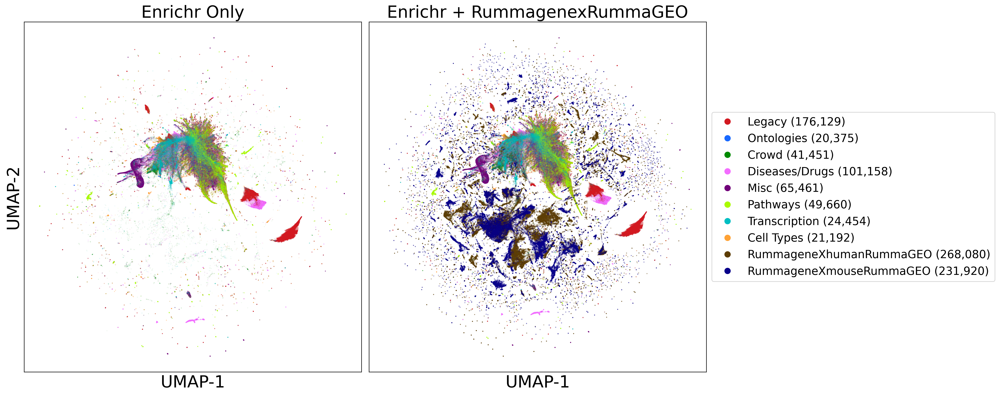

In [35]:
#together
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

# Data for the first plot
_ = meta[(meta['category'] != 'RummageneXhumanRummaGEO') & (meta['category'] != 'RummageneXmouseRummaGEO')]
# _ = meta[meta['category'] != 'RummagenexRummaGEO']

cat = 'category'
cats = _[cat].unique()
color_pallete = dict(zip(cats, glasbey.create_palette(len(cats))))

# Create a figure with two subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8), dpi=300)  # 1 row, 2 columns

# First subplot: scatter plot without the legend
for label, data in _.groupby(cat):
    ax1.scatter(
        x=data['UMAP-1'],
        y=data['UMAP-2'],
        s=0.1,  # Adjusted size of the points
        color=color_pallete[label],
        alpha=0.1,
        rasterized=True,
    )
ax1.set_xlabel('UMAP-1', fontdict=dict(size=24))
ax1.set_ylabel('UMAP-2', fontdict=dict(size=24))
ax1.set_xticks([])
ax1.set_yticks([])
ax1.set_title('Enrichr Only', fontsize=24)

_ = meta
cat = 'category'
cats = _[cat].unique()
color_pallete = dict(zip(cats, glasbey.create_palette(len(cats))))

for label, data in _.groupby(cat):
    ax2.scatter(
        x=data['UMAP-1'],
        y=data['UMAP-2'],
        s=0.1,  
        color=color_pallete[label],
        alpha=0.1,
        rasterized=True,
    )

# Add legend to the second subplot
lgd = ax2.legend(handles=[
    Line2D([0], [0], marker='o', color='w', label=f"{label} ({int((_[cat] == label).sum()):,})",
           markerfacecolor=color_pallete[label], markersize=10)
    for label in cats
], loc='center left', bbox_to_anchor=(1, 0.5), fontsize=16)

ax2.set_xlabel('UMAP-1', fontdict=dict(size=24))
ax2.set_xticks([])
ax2.set_yticks([])
ax2.set_title('Enrichr + RummagenexRummaGEO', fontsize=24)
plt.tight_layout()
# plt.savefig(f"{fig_dir}/enrichr_rummageogene_combined.png", dpi=300)
# plt.savefig(f"{fig_dir}/enrichr_rummageogene_combined.pdf", dpi=300)
plt.show()

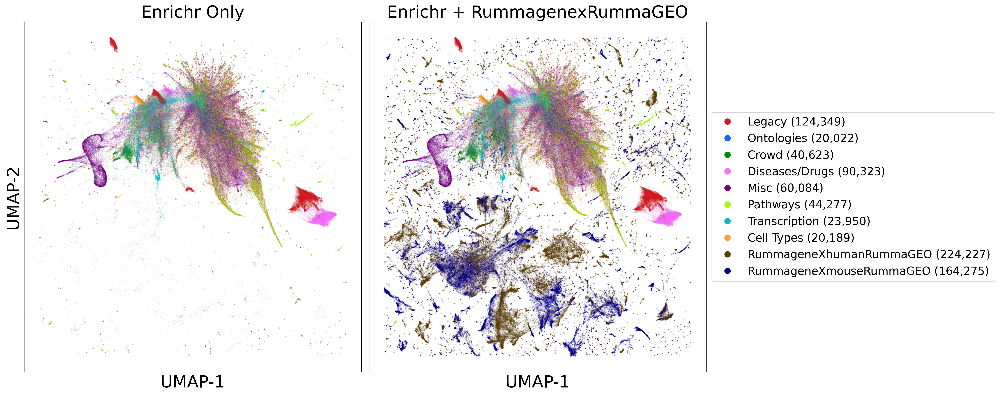

In [36]:
#together
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

# Data for the first plot
_ = meta[((meta['category'] != 'RummageneXhumanRummaGEO') & (meta['category'] != 'RummageneXmouseRummaGEO') & ~meta['outlier'].astype(bool))]
# _ = meta[meta['category'] != 'RummagenexRummaGEO']

cat = 'category'
cats = _[cat].unique()
color_pallete = dict(zip(cats, glasbey.create_palette(len(cats))))

# Create a figure with two subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8), dpi=300)  # 1 row, 2 columns

# First subplot: scatter plot without the legend
for label, data in _.groupby(cat):
    ax1.scatter(
        x=data['UMAP-1'],
        y=data['UMAP-2'],
        s=0.1,  # Adjusted size of the points
        color=color_pallete[label],
        alpha=0.1,
        rasterized=True,
    )
ax1.set_xlabel('UMAP-1', fontdict=dict(size=24))
ax1.set_ylabel('UMAP-2', fontdict=dict(size=24))
ax1.set_xticks([])
ax1.set_yticks([])
ax1.set_title('Enrichr Only', fontsize=24)

_ = meta[(~meta['outlier'].astype(bool))]
cat = 'category'
cats = _[cat].unique()
color_pallete = dict(zip(cats, glasbey.create_palette(len(cats))))

for label, data in _.groupby(cat):
    ax2.scatter(
        x=data['UMAP-1'],
        y=data['UMAP-2'],
        s=0.1,  
        color=color_pallete[label],
        alpha=0.1,
        rasterized=True,
    )

# Add legend to the second subplot
lgd = ax2.legend(handles=[
    Line2D([0], [0], marker='o', color='w', label=f"{label} ({int((_[cat] == label).sum()):,})",
           markerfacecolor=color_pallete[label], markersize=10)
    for label in cats
], loc='center left', bbox_to_anchor=(1, 0.5), fontsize=16)

ax2.set_xlabel('UMAP-1', fontdict=dict(size=24))
ax2.set_xticks([])
ax2.set_yticks([])
ax2.set_title('Enrichr + RummagenexRummaGEO', fontsize=24)
plt.tight_layout()
# plt.savefig(f"{fig_dir}/enrichr_rummageogene_combined.png", dpi=300)
# plt.savefig(f"{fig_dir}/enrichr_rummageogene_combined.pdf", dpi=300)
plt.show()

In [37]:
meta["color"] = meta['category'].apply(color_pallete.get)
meta

,source,term,UMAP-1,UMAP-2,outlier,cluster,category,color
0,KEGG_2013,HSA00010 GLYCOLYSIS AND GLUCONEOGENESIS,5.523565,9.771139,0,-1,Legacy,#d21820
1,KEGG_2013,HSA00020 CITRATE CYCLE,5.275534,10.659683,0,-1,Legacy,#d21820
2,KEGG_2013,HSA00030 PENTOSE PHOSPHATE PATHWAY,5.309891,9.499683,0,298,Legacy,#d21820
3,KEGG_2013,HSA00040 PENTOSE AND GLUCURONATE INTERCONVERSIONS,6.372071,7.690321,0,-1,Legacy,#d21820
4,KEGG_2013,HSA00051 FRUCTOSE AND MANNOSE METABOLISM,5.156849,9.371234,0,298,Legacy,#d21820
...,...,...,...,...,...,...,...,...
999875,rummagenexrummageo-mouse,PMC10103678-11427_2023_2316_MOESM5_ESM.xls-mRN...,10.498696,12.207009,0,148,RummageneXmouseRummaGEO,#08008a
999876,rummagenexrummageo-mouse,PMC9465963-13059_2022_2760_MOESM13_ESM.xlsx-Fi...,10.499341,12.206306,0,148,RummageneXmouseRummaGEO,#08008a
999877,rummagenexrummageo-mouse,PMC10897180-41467_2024_45984_MOESM9_ESM.xlsx-F...,-4.049915,-10.885347,1,27,RummageneXmouseRummaGEO,#08008a
999878,rummagenexrummageo-human,PMC5605457-NIHMS896444-supplement-2.xlsx-Sheet...,-0.623575,0.147638,0,138,RummageneXhumanRummaGEO,#5d3d04


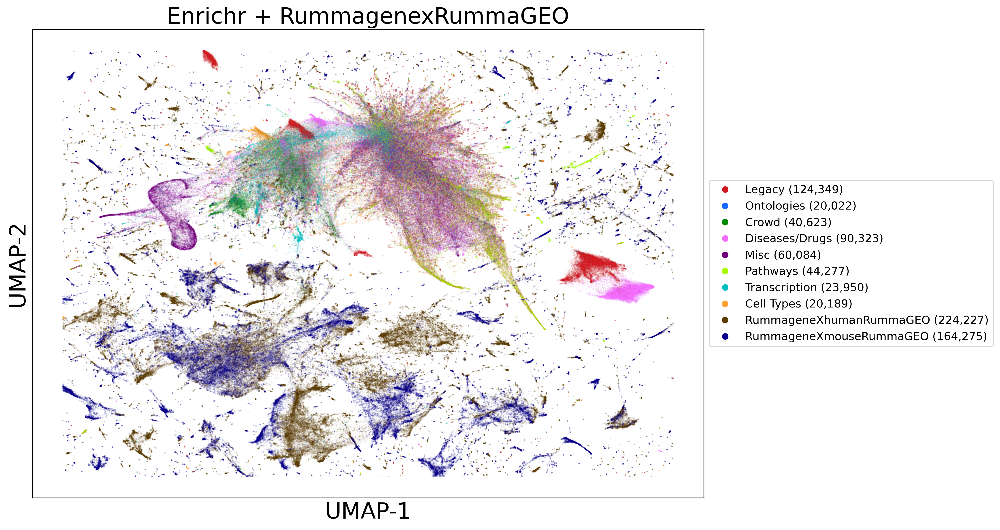

In [38]:
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

fig = plt.figure(figsize=(15, 8), dpi=300)

for label, data in _.groupby(cat):
    ax2.scatter(
        x=data['UMAP-1'],
        y=data['UMAP-2'],
        s=0.1,  
        color=color_pallete[label],
        alpha=0.1,
        rasterized=True,
    )

for label, data in _.groupby(cat):
    plt.scatter(
        x=data['UMAP-1'],
        y=data['UMAP-2'],
        s=0.1, 
        color=color_pallete[label],
        alpha=0.1,
        rasterized=True,
    )

plt.legend(handles=[
    Line2D([0], [0], marker='o', color='w', label=f"{label} ({int((_[cat] == label).sum()):,})",
           markerfacecolor=color_pallete[label], markersize=8)
    for label in cats
], loc='center left', bbox_to_anchor=(1, 0.5), fontsize=12)

plt.xlabel('UMAP-1', fontdict=dict(size=24))
plt.ylabel('UMAP-2', fontdict=dict(size=24))
plt.xticks([])
plt.yticks([])
plt.title('Enrichr + RummagenexRummaGEO', fontsize=24)
plt.savefig(f"{fig_dir}/enrichr_rummageogeneonly.png", dpi=300)
plt.tight_layout()
plt.show()


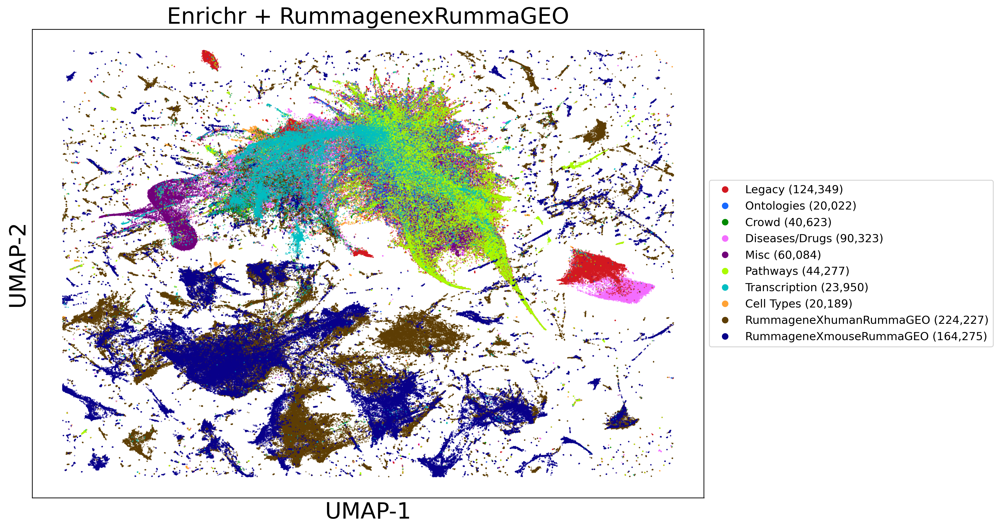

In [39]:
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D

unique_data = _.loc[~_.duplicated(subset=['UMAP-1', 'UMAP-2'], keep=False)]

fig = plt.figure(figsize=(15, 8), dpi=300)

for label, data in unique_data.groupby(cat):
    plt.scatter(
        x=data['UMAP-1'],
        y=data['UMAP-2'],
        s=0.1,  
        color=color_pallete[label],
        alpha=0.8,
        rasterized=True,
    )

plt.legend(handles=[
    Line2D([0], [0], marker='o', color='w', label=f"{label} ({int((unique_data[cat] == label).sum()):,})",
           markerfacecolor=color_pallete[label], markersize=8)
    for label in cats
], loc='center left', bbox_to_anchor=(1, 0.5), fontsize=12)

plt.xlabel('UMAP-1', fontdict=dict(size=24))
plt.ylabel('UMAP-2', fontdict=dict(size=24))
plt.xticks([])
plt.yticks([])
plt.title('Enrichr + RummagenexRummaGEO', fontsize=24)
plt.tight_layout()
plt.show()


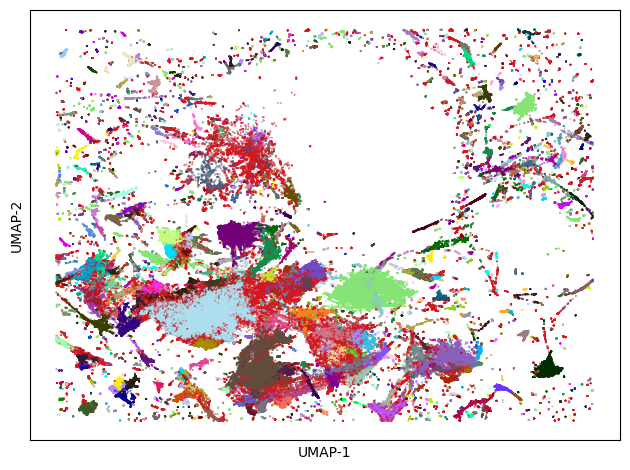

In [40]:
# m = meta
# m =  meta[outlier&(meta['source']!='rummagene')]
# unique_data = unique_data.loc[~_.duplicated(subset=['UMAP-1', 'UMAP-2'], keep=False)]
m = meta[((meta['category'] == 'RummageneXhumanRummaGEO') | (meta['category'] == 'RummageneXmouseRummaGEO'))]
# print(m.columns)
# m = m.loc[~m.duplicated(subset=['UMAP-1', 'UMAP-2'], keep=False)]
m =  m.loc[~m['outlier'].astype(bool)]
# print(m.columns)


cats = np.unique(m['cluster'])
color_pallete = dict(zip(cats, glasbey.create_palette(len(cats))))
plt.scatter(m['UMAP-1'], m['UMAP-2'],
            s=0.1, c=m['cluster'].apply(color_pallete.get))
plt.xlabel('UMAP-1')
plt.ylabel('UMAP-2')
plt.xticks([])
plt.yticks([])
plt.tight_layout()
# lgd = plt.legend(handles=[
#   Line2D([0], [0], marker='o', color='w', label=label,
#         markerfacecolor=color_pallete[label], markersize=10)
#   for label in cats
# ], bbox_to_anchor=(0.5, -0.1), loc='upper center', borderaxespad=0)
plt.show()


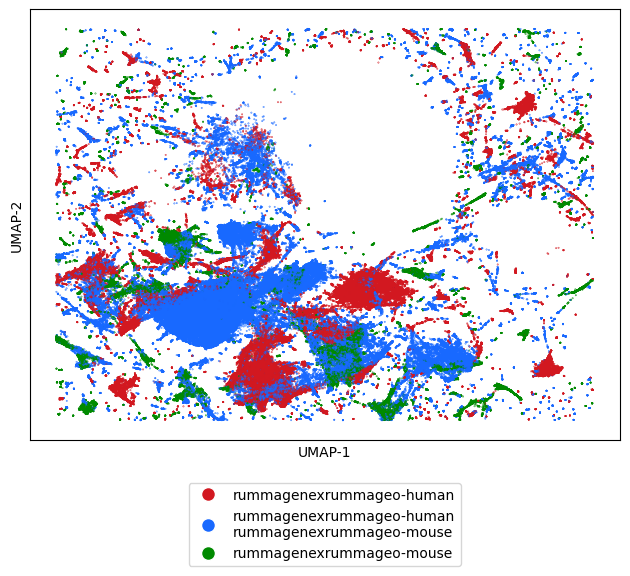

In [41]:
from collections import Counter

C = pd.DataFrame(m[['cluster', 'source']].groupby('cluster')['source'].agg(Counter).to_dict())
m['annot'] = 'unknown'
for clust in C.columns:
  c = C[clust].dropna()
  c = c / c.sum()
  m.loc[m['cluster'] == clust, 'annot'] = '\n'.join(c[c > 0.25].index) or 'unknown'

m1 = m[m['annot']=='unknown']
m2 = m[m['annot']!='unknown']
cats = np.unique(m2['annot'])
color_pallete = dict(zip(cats, glasbey.create_palette(len(cats))))
plt.scatter(m1['UMAP-1'], m1['UMAP-2'],
            s=0.1, c='grey', alpha=0.1)
plt.scatter(m2['UMAP-1'], m2['UMAP-2'],
            s=0.1, c=m2['annot'].apply(color_pallete.get))
plt.xlabel('UMAP-1')
plt.ylabel('UMAP-2')
plt.xticks([])
plt.yticks([])
plt.tight_layout()
lgd = plt.legend(handles=[
  Line2D([0], [0], marker='o', color='w', label=label,
        markerfacecolor=color_pallete[label], markersize=10)
  for label in cats
], bbox_to_anchor=(0.5, -0.1), loc='upper center', borderaxespad=0)
plt.show()

In [42]:
m2

,source,term,UMAP-1,UMAP-2,outlier,cluster,category,color,annot
499880,rummagenexrummageo-human,PMC7185143-aging-12-102991-s001..docx-0-Gene_n...,5.479878,-4.498008,0,215,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human\nrummagenexrummageo-m...
499881,rummagenexrummageo-human,PMC9762333-ccr-21-3329_supplementary_tables_1-...,5.466085,-4.532388,0,215,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human\nrummagenexrummageo-m...
499882,rummagenexrummageo-human,PMC7185143-aging-12-102991-s001..docx-0-Gene_n...,5.444767,-4.472114,0,215,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human\nrummagenexrummageo-m...
499883,rummagenexrummageo-human,PMC9762333-ccr-21-3329_supplementary_tables_1-...,5.448868,-4.482871,0,215,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human\nrummagenexrummageo-m...
499884,rummagenexrummageo-human,PMC7185143-aging-12-102991-s001..docx-0-Gene_n...,5.482417,-4.496984,0,215,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human\nrummagenexrummageo-m...
...,...,...,...,...,...,...,...,...,...
999873,rummagenexrummageo-mouse,PMC8900158-Table_1.xlsx-S3_DEGs_In_vitro_stimu...,2.706369,-6.846542,0,50,RummageneXmouseRummaGEO,#08008a,rummagenexrummageo-human\nrummagenexrummageo-m...
999875,rummagenexrummageo-mouse,PMC10103678-11427_2023_2316_MOESM5_ESM.xls-mRN...,10.498696,12.207009,0,148,RummageneXmouseRummaGEO,#08008a,rummagenexrummageo-mouse
999876,rummagenexrummageo-mouse,PMC9465963-13059_2022_2760_MOESM13_ESM.xlsx-Fi...,10.499341,12.206306,0,148,RummageneXmouseRummaGEO,#08008a,rummagenexrummageo-mouse
999878,rummagenexrummageo-human,PMC5605457-NIHMS896444-supplement-2.xlsx-Sheet...,-0.623575,0.147638,0,138,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human


In [43]:
len(m2["cluster"].unique())

255

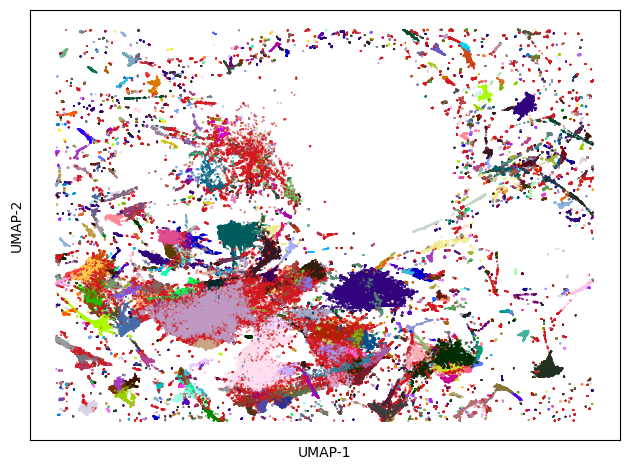

In [44]:
from collections import Counter

C = pd.DataFrame(m[['cluster', 'source']].groupby('cluster')['source'].agg(Counter).to_dict())
m['annot'] = 'unknown'
for clust in C.columns:
  c = C[clust].dropna()
  c = c / c.sum()
  m.loc[m['cluster'] == clust, 'annot'] = '\n'.join(c[c > 0.25].index) or 'unknown'

m1 = m[m['annot']=='unknown']
m2 = m[m['annot']!='unknown']
m2['annot_clust'] = m2['annot'] + "_" + m2['cluster'].astype(str)
# print(m2)

cats = np.unique(m2['annot_clust'])
color_pallete = dict(zip(cats, glasbey.create_palette(len(cats))))
plt.scatter(m1['UMAP-1'], m1['UMAP-2'],
            s=0.1, c='grey', alpha=0.1)
plt.scatter(m2['UMAP-1'], m2['UMAP-2'],
            s=0.1, c=m2['annot_clust'].apply(color_pallete.get))
plt.xlabel('UMAP-1')
plt.ylabel('UMAP-2')
plt.xticks([])
plt.yticks([])
plt.tight_layout()
# lgd = plt.legend(handles=[
#   Line2D([0], [0], marker='o', color='w', label=label,
#         markerfacecolor=color_pallete[label], markersize=10)
#   for label in cats
# ], bbox_to_anchor=(0.5, -0.1), loc='upper center', borderaxespad=0)
plt.show()

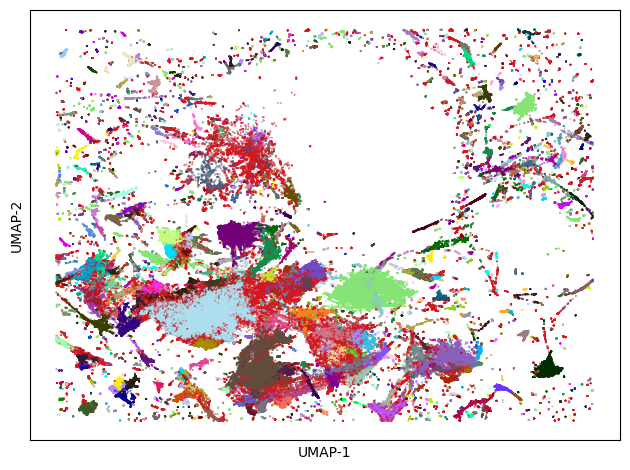

In [45]:
from collections import Counter

C = pd.DataFrame(m[['cluster', 'source']].groupby('cluster')['source'].agg(Counter).to_dict())
m['annot'] = 'unknown'
for clust in C.columns:
  c = C[clust].dropna()
  c = c / c.sum()
  m.loc[m['cluster'] == clust, 'annot'] = '\n'.join(c[c > 0.25].index) or 'unknown'

m1 = m[m['annot']=='unknown']
m2 = m[m['annot']!='unknown']
m2['annot_clust'] = m2['annot'] + "_" + m2['cluster'].astype(str)
# print(m2)

cats = np.unique(m2['cluster'])
color_pallete = dict(zip(cats, glasbey.create_palette(len(cats))))
plt.scatter(m1['UMAP-1'], m1['UMAP-2'],
            s=0.1, c='grey', alpha=0.1)
plt.scatter(m2['UMAP-1'], m2['UMAP-2'],
            s=0.1, c=m2['cluster'].apply(color_pallete.get))
plt.xlabel('UMAP-1')
plt.ylabel('UMAP-2')
plt.xticks([])
plt.yticks([])
plt.tight_layout()
# lgd = plt.legend(handles=[
#   Line2D([0], [0], marker='o', color='w', label=label,
#         markerfacecolor=color_pallete[label], markersize=10)
#   for label in cats
# ], bbox_to_anchor=(0.5, -0.1), loc='upper center', borderaxespad=0)
plt.show()

In [46]:
d = m.copy()
# lst = [165, 76, 247]
lst = [76]
d = d[d['cluster'].isin(lst)]
d


,source,term,UMAP-1,UMAP-2,outlier,cluster,category,color,annot
500760,rummagenexrummageo-human,PMC1636363-nar_gkl590_Supplementary_table_1_re...,-5.671105,3.001482,0,76,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human
500777,rummagenexrummageo-human,PMC1636363-nar_gkl590_Supplementary_table_1_re...,-5.667193,3.004209,0,76,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human
501542,rummagenexrummageo-human,PMC4086339-molcell-37-6-457-supplementary2.xls...,10.619825,8.606674,0,76,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human
501804,rummagenexrummageo-human,PMC9034549-13046_2022_2344_MOESM1_ESM.xlsx-she...,4.591569,-2.044535,0,76,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human
501947,rummagenexrummageo-human,PMC1636363-nar_gkl590_Supplementary_table_1_re...,-5.690879,3.000465,0,76,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human
...,...,...,...,...,...,...,...,...,...
999663,rummagenexrummageo-human,PMC11101681-mmc5.xlsx-SAINT_NT_Analysis_CDC45_...,4.865023,-2.292973,0,76,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human
999664,rummagenexrummageo-human,PMC11101681-mmc5.xlsx-SAINT_NT_Analysis_CDC45_...,4.865602,-2.289607,0,76,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human
999813,rummagenexrummageo-human,PMC9217975-41419_2022_5003_MOESM20_ESM.xlsx-CV...,5.838461,-2.140061,0,76,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human
999851,rummagenexrummageo-human,PMC9191665-pnas.2200363119.sd01.xlsx-20180802-...,3.910198,-1.709187,0,76,RummageneXhumanRummaGEO,#5d3d04,rummagenexrummageo-human


In [47]:
# print(dlfjdlfkjkdjf)

NameError: name 'dlfjdlfkjkdjf' is not defined

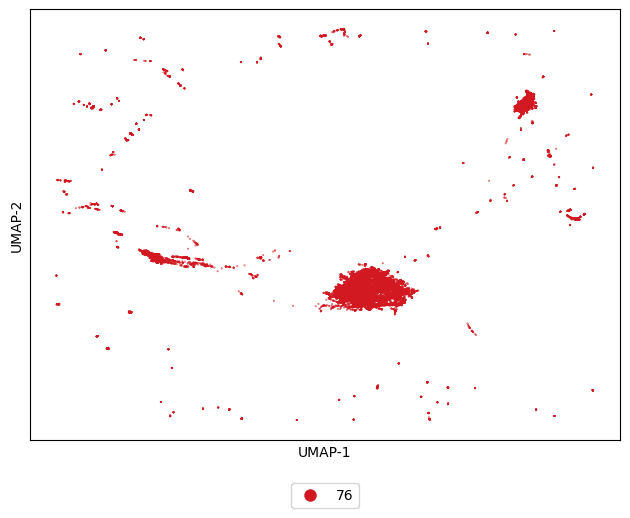

In [48]:
from collections import Counter

C = pd.DataFrame(d[['cluster', 'source']].groupby('cluster')['source'].agg(Counter).to_dict())
d['annot'] = 'unknown'
for clust in C.columns:
  c = C[clust].dropna()
  c = c / c.sum()
  d.loc[d['cluster'] == clust, 'annot'] = '\n'.join(c[c > 0.25].index) or 'unknown'

m1 = d[d['annot']=='unknown']
m2 = d[d['annot']!='unknown']
m2['annot_clust'] = m2['annot'] + "_" + m2['cluster'].astype(str)
# print(m2)

cats = np.unique(m2['cluster'])
color_pallete = dict(zip(cats, glasbey.create_palette(len(cats))))
plt.scatter(m1['UMAP-1'], m1['UMAP-2'],
            s=0.1, c='grey', alpha=0.1)
plt.scatter(m2['UMAP-1'], m2['UMAP-2'],
            s=0.1, c=m2['cluster'].apply(color_pallete.get))
plt.xlabel('UMAP-1')
plt.ylabel('UMAP-2')
plt.xticks([])
plt.yticks([])
plt.tight_layout()
lgd = plt.legend(handles=[
  Line2D([0], [0], marker='o', color='w', label=label,
        markerfacecolor=color_pallete[label], markersize=10)
  for label in cats
], bbox_to_anchor=(0.5, -0.1), loc='upper center', borderaxespad=0)
plt.show()

In [ ]:
#selecting clusters
import plotly.express as px
from dash import Dash, dcc, html
from dash.dependencies import Input, Output
import csv

# Filter the data 
# _ = meta[(meta['category'] == 'RummagenexRummaGEO_human') | (meta['category'] == 'RummagenexRummaGEO_mouse')]

# Generate color palette
# cat = 'category'
cats = d[cat].unique()
color_palette = dict(zip(cats, glasbey.create_palette(len(cats))))

# Create a color column based on the category
_['color'] = _[cat].map(color_palette)

# Create the plot
fig = px.scatter(
    d,
    x='UMAP-1',
    y='UMAP-2',
    color='category',
    color_discrete_map=color_palette,
    title="UMAP Scatter Plot",
    labels={'UMAP-1': 'UMAP-1', 'UMAP-2': 'UMAP-2'},
    opacity=0.1
)
fig.update_traces(marker=dict(size=1))

# Customize the layout
fig.update_layout(
    legend=dict(
        title="Category",
        yanchor="top",
        y=0.99,
        xanchor="left",
        x=1.02,
        bordercolor="Black",
        borderwidth=1
    ),
    xaxis=dict(showticklabels=False, showgrid=False),
    yaxis=dict(showticklabels=False, showgrid=False),
    margin=dict(l=0, r=0, t=20, b=0),  # Tighten the figure
    width=1000,
    height=800,
)

app = Dash(__name__)

app.layout = html.Div([
    dcc.Graph(
        id='scatter-plot',
        figure=fig
    ),
    html.Div(id='selected-data')
])

@app.callback(
    Output('selected-data', 'children'),
    Input('scatter-plot', 'selectedData')
)
def display_selected_data(selectedData):
    if selectedData is None:
        return "Select points on the scatter plot to see their (x, y) values."
    
    points = selectedData['points']
    selected_points = [(p['x'], p['y']) for p in points]

    # Write selected points to a CSV file
    with open('selected_points.csv', 'w', newline='') as csvfile:
        csvwriter = csv.writer(csvfile)
        csvwriter.writerow(['UMAP-1', 'UMAP-2'])  # Write the header
        csvwriter.writerows(selected_points)  # Write the data rows

    return f"{len(selected_points)} points have been written to selected_points.csv"

# app.run_server(debug=True)
app.run_server()


fig.show()


In [ ]:
dfe = pd.read_csv("selected_points.csv")
dfe


In [ ]:
def fin_tab(df1, df2, cols):
    r = pd.merge(df1, df2, on=cols)
    return r
l = fin_tab(meta, dfe, ["UMAP-1", "UMAP-2"])
l

In [ ]:
df = pd.read_csv("data/rummagenexrummageo_sym4_500k.csv", usecols=["rummagene", "rummageo", "species", "overlaps"])


In [ ]:
# l.loc[((l['category'] == 'RummageneXhumanRummaGEO') | (l['category'] == 'RummageneXmouseRummaGEO'))]
df["term"] = df["rummagene"] + ";" + df["rummageo"]
# dfi = df[["term", "overlaps", "rumma"]]
l = fin_tab(l, df, ["term"])
l

In [ ]:
# l.to_csv("bottom_left_red_cluster_76.csv", index=False)

In [ ]:
df.columns

In [ ]:
df.columns

In [ ]:
# filtered_C.shape


In [ ]:
svs = np.load('data/svs_sym.npy')
svs


In [ ]:
from scipy.spatial.distance import pdist, squareform
import numpy as np

# Step 1: Compute cluster centroids
cluster_labels = meta['cluster'].unique()
centroids = {
    cluster: svs[meta['cluster'] == cluster].mean(axis=0)
    for cluster in cluster_labels if cluster != -1  # Exclude noise if HDBSCAN used
}

# Step 2: Compute pairwise distances between centroids
centroid_matrix = np.vstack([centroids[cluster] for cluster in centroids])
distance_matrix = squareform(pdist(centroid_matrix, metric='cosine'))  # Or 'euclidean'

# Step 3: Merge close clusters
threshold = 0.1  # Adjust based on your data
merge_map = {}
for i, cluster_a in enumerate(centroids):
    for j, cluster_b in enumerate(centroids):
        if i < j and distance_matrix[i, j] < threshold:
            merge_map[cluster_b] = cluster_a

# Step 4: Apply the merging map
# Create a new column for the merged clusters
meta['merged_cluster'] = meta['cluster'].replace(merge_map)

# Optional: Re-label clusters to make them sequential (e.g., 0, 1, 2, ...)
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()
meta['merged_cluster'] = encoder.fit_transform(meta['merged_cluster'])

# Verify the changes
print(meta[['cluster', 'merged_cluster']].drop_duplicates())


In [ ]:
print(len(meta["cluster"].unique()))
print(len(meta["merged_cluster"].unique()))

In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(meta['UMAP-1'], meta['UMAP-2'], c=meta['merged_cluster'], s=1, cmap='tab20', alpha=0.6)
plt.xlabel('UMAP-1')
plt.ylabel('UMAP-2')
plt.title('Post-Processed Clusters')
plt.colorbar(label='Merged Cluster')
plt.tight_layout()
plt.show()


In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(meta['UMAP-1'], meta['UMAP-2'], c=meta['cluster'], cmap='tab20', s=1, alpha=0.6)
plt.scatter(meta[meta['cluster'] == -1]['UMAP-1'], 
            meta[meta['cluster'] == -1]['UMAP-2'], 
            c='grey', s=1, label='Noise', alpha=0.6)
plt.xlabel('UMAP-1')
plt.ylabel('UMAP-2')
plt.title('HDBSCAN Clustering with Noise Points')
plt.legend()
plt.tight_layout()
plt.show()


In [ ]:
from scipy.spatial.distance import pdist, squareform
import numpy as np


# Step 1: Remove noise points
non_noise_meta = meta[meta['cluster'] != -1]
non_noise_svs = svs[meta['cluster'] != -1]  # Align the embedding data

# Step 2: Recompute centroids
cluster_labels = non_noise_meta['cluster'].unique()
centroids = {
    cluster: non_noise_svs[non_noise_meta['cluster'] == cluster].mean(axis=0)
    for cluster in cluster_labels
}

# Step 3: Compute pairwise distances between centroids
centroid_matrix = np.vstack([centroids[cluster] for cluster in centroids])
distance_matrix = squareform(pdist(centroid_matrix, metric='cosine'))  # Or 'euclidean'

# Step 4: Merge clusters based on distance threshold
threshold = 0.1  # Adjust based on your dataset
merge_map = {}
for i, cluster_a in enumerate(centroids):
    for j, cluster_b in enumerate(centroids):
        if i < j and distance_matrix[i, j] < threshold:
            merge_map[cluster_b] = cluster_a

# Step 5: Update the cluster labels with merged clusters
non_noise_meta['merged_cluster'] = non_noise_meta['cluster'].replace(merge_map)

# Optional: Re-label clusters to make them sequential (e.g., 0, 1, 2, ...)
from sklearn.preprocessing import LabelEncoder
encoder = LabelEncoder()
non_noise_meta['merged_cluster'] = encoder.fit_transform(non_noise_meta['merged_cluster'])

# Verify the changes
print(non_noise_meta[['cluster', 'merged_cluster']].drop_duplicates())


In [ ]:
non_noise_meta

In [ ]:
plt.figure(figsize=(8, 6))
non_noise_meta = non_noise_meta[((non_noise_meta['category'] == 'RummageneXhumanRummaGEO') | (non_noise_meta['category'] == 'RummageneXmouseRummaGEO'))]
non_noise_meta = non_noise_meta[(~non_noise_meta['outlier'].astype(bool))]

plt.scatter(non_noise_meta['UMAP-1'], non_noise_meta['UMAP-2'], 
            c=non_noise_meta['merged_cluster'], cmap='tab20', s=1, alpha=0.6)
plt.xlabel('UMAP-1')
plt.ylabel('UMAP-2')
plt.title('Clusters After Removing Noise and Merging')
plt.colorbar(label='Merged Cluster')
plt.tight_layout()
plt.show()


In [ ]:
for threshold in [0.05, 0.1, 0.2, 0.3]:
    merge_map = {}
    for i, cluster_a in enumerate(centroids):
        for j, cluster_b in enumerate(centroids):
            if i < j and distance_matrix[i, j] < threshold:
                merge_map[cluster_b] = cluster_a

    merged_labels = non_noise_meta['cluster'].replace(merge_map)
    print(f"Threshold: {threshold}, Number of clusters: {merged_labels.nunique()}")
